### Student Information
Name:吳霽函

Student ID:109065523

GitHub ID:crescendoCat

---

### Instructions

1. First: do the **take home** exercises in the [DM2020-Lab1-Master Repo](https://github.com/fhcalderon87/DM2020-Lab1-Master). You may need to copy some cells from the Lab notebook to this notebook. __This part is worth 20% of your grade.__


2. Second: follow the same process from the [DM2020-Lab1-Master Repo](https://github.com/fhcalderon87/DM2020-Lab1-Master) on **the new dataset**. You don't need to explain all details as we did (some **minimal comments** explaining your code are useful though).  __This part is worth 30% of your grade.__
    - Download the [the new dataset](https://archive.ics.uci.edu/ml/datasets/Sentiment+Labelled+Sentences#). The dataset contains a `sentence` and `score` label. Read the specificiations of the dataset for details. 
    - You are allowed to use and modify the `helper` functions in the folder of the first lab session (notice they may need modification) or create your own.


3. Third: please attempt the following tasks on **the new dataset**. __This part is worth 30% of your grade.__
    - Generate meaningful **new data visualizations**. Refer to online resources and the Data Mining textbook for inspiration and ideas. 
    - Generate **TF-IDF features** from the tokens of each text. This will generating a document matrix, however, the weights will be computed differently (using the TF-IDF value of each word per document as opposed to the word frequency). Refer to this Sciki-learn [guide](http://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html) .
    - Implement a simple **Naive Bayes classifier** that automatically classifies the records into their categories. Use both the TF-IDF features and word frequency features to build two seperate classifiers. Comment on the differences.  Refer to this [article](https://hub.packtpub.com/implementing-3-naive-bayes-classifiers-in-scikit-learn/).


4. Fourth: In the lab, we applied each step really quickly just to illustrate how to work with your dataset. There are somethings that are not ideal or the most efficient/meaningful. Each dataset can be habdled differently as well. What are those inefficent parts you noticed? How can you improve the Data preprocessing for these specific datasets? __This part is worth 10% of your grade.__


5. Fifth: It's hard for us to follow if your code is messy :'(, so please **tidy up your notebook** and **add minimal comments where needed**. __This part is worth 10% of your grade.__


You can submit your homework following these guidelines: [Git Intro & How to hand your homework](https://github.com/fhcalderon87/DM2020-Lab1-Master/blob/master/Git%20Intro%20%26%20How%20to%20hand%20your%20homework.ipynb). Make sure to commit and save your changes to your repository __BEFORE the deadline (Oct. 22th 11:59 pm, Thursday)__. 

## 1. Take Home Exercises

In [1]:
# TEST necessary for when working with external scripts
%load_ext autoreload
%autoreload 2

### Data Preparation
Preparing the data for __Take Home Exercises__.

In [2]:
import numpy as np
from sklearn.datasets import fetch_20newsgroups
import pandas as pd
# PA's useful functions
import helpers.data_mining_helpers as dmh
import plotly.express as px

In [3]:
# categories
categories = ['alt.atheism', 'soc.religion.christian', 'comp.graphics', 'sci.med']

twenty_train = fetch_20newsgroups(subset='train', categories=categories, \
                                  shuffle=True, random_state=42)



# construct dataframe from a list
X = pd.DataFrame.from_records(dmh.format_rows(twenty_train), columns= ['text'])

In [4]:
X['category'] = twenty_train.target
X['category_name'] = X.category.apply(lambda t: dmh.format_labels(t, twenty_train))

### >>>  **Exercise 2 (take home):** 
Experiment with other querying techniques using pandas dataframes. Refer to their [documentation](https://pandas.pydata.org/pandas-docs/stable/indexing.html) for more information. 

### My Answer ###
The following cells, I try to figure out the number of the row which text's lenght is over 700.\
And I try drawing a bar plot to visualize this thing

In [5]:
import numpy as np
import matplotlib.pyplot as plt
vlen = np.vectorize(len)
# vectorize python len function to compute each text's length in the data
print(vlen(X['text']))
# Select those text length > 700, pick the category column only
X.loc[vlen(X['text']) > 700, 'category']

[  686  1004  3200 ...  3412 19372   654]


1       1
2       3
4       3
5       3
6       3
       ..
2250    0
2252    2
2253    2
2254    2
2255    2
Name: category, Length: 1812, dtype: int64

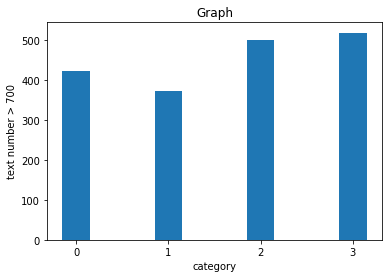

In [6]:
bins = [-0.5, 0.5, 1.5, 2.5, 3.5]

# Compute the histogram. Classify the data using category
hist = np.histogram(X.loc[vlen(X['text']) > 700, 'category'], bins=bins)
plt.bar([0, 1, 2, 3], hist[0], width=0.3)
plt.xticks([0, 1, 2, 3])
plt.xlabel('category')
plt.ylabel('text number > 700')
plt.title('Graph')
plt.show()

Also we can set different threshold on text length to see a rough distribution of text length in the data set.

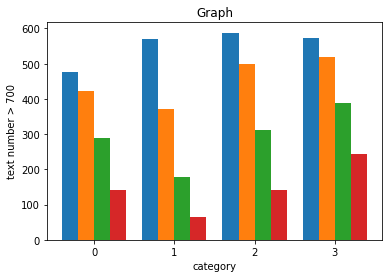

In [7]:
bins = [-0.5, 0.5, 1.5, 2.5, 3.5]
xtick = np.array([0, 1, 2, 3])

for threshold, pos in zip([300, 700, 1200, 2000], [-0.3, -0.1, 0.1, 0.3]):
    hist = np.histogram(X.loc[vlen(X['text']) > threshold, 'category'], bins=bins)
    plt.bar(xtick + pos, hist[0], width=0.2) 
plt.xticks([0, 1, 2, 3])
plt.xlabel('category')
plt.ylabel('text number > 700')
plt.title('Graph')
plt.show()

### >>> **Exercise 5 (take home)** 
There is an old saying that goes, "The devil is in the details." When we are working with extremely large data, it's difficult to check records one by one (as we have been doing so far). And also, we don't even know what kind of missing values we are facing. Thus, "debugging" skills get sharper as we spend more time solving bugs. Let's focus on a different method to check for missing values and the kinds of missing values you may encounter. It's not easy to check for missing values as you will find out in a minute.

Please check the data and the process below, describe what you observe and why it happened.   
$Hint$ :  why `.isnull()` didn't work?

In [8]:
NA_dict = [{ 'id': 'A', 'missing_example': np.nan },
           { 'id': 'B'                    },
           { 'id': 'C', 'missing_example': 'NaN'  },
           { 'id': 'D', 'missing_example': 'None' },
           { 'id': 'E', 'missing_example':  None  },
           { 'id': 'F', 'missing_example': ''     }]

NA_df = pd.DataFrame(NA_dict, columns = ['id','missing_example'])
NA_df

,id,missing_example
0,A,NaN
1,B,NaN
2,C,NaN
3,D,None
4,E,None
5,F,


In [9]:
NA_df['missing_example'].isnull()

0     True
1     True
2    False
3    False
4     True
5    False
Name: missing_example, dtype: bool

### My Answer ###
The value in 2 and 3 are 'NaN', 'None'. pd.isnull() will see them as a 'string'. Since they are 'string' types, they are not 'null' anymore. \
Also, the value in 5 is a empty string, its also a string so pd.isnull() will take it as a 'string' type instead of python 'None' type

### >>> Exercise 6 (take home):
Notice any changes to the `X` dataframe? What are they? Report every change you noticed as compared to the previous state of `X`. Feel free to query and look more closely at the dataframe for these changes.

In [10]:
X_sample = X.sample(n=1000) #random state
print(len(X_sample))
X_sample.head()

1000


,text,category,category_name
115,"Subject: ""STAR GARTDS"" <sp?> Info wanted From:...",2,sci.med
1688,From: homer@tripos.com (Webster Homer) Subject...,2,sci.med
1821,From: turner@reed.edu (Havok impersonated) Sub...,2,sci.med
2189,From: schultz@schultz.kgn.ibm.com (Karl Schult...,1,comp.graphics
1277,From: Peter.vanderveen@visser.el.wau.nl (Pete...,1,comp.graphics


In [11]:
len(X)

2257

### My Answer ###
The size of X_sample is 1000, smaller then original X. And also the order of X_sample is disrupted due to the random sample process.

### >>> **Exercise 8 (take home):** 
We can also do a side-by-side comparison of the distribution between the two datasets, but maybe you can try that as an excerise. Below we show you an snapshot of the type of chart we are looking for. 

![alt txt](https://i.imgur.com/9eO431H.png)

<AxesSubplot:title={'center':'Category distribution'}>

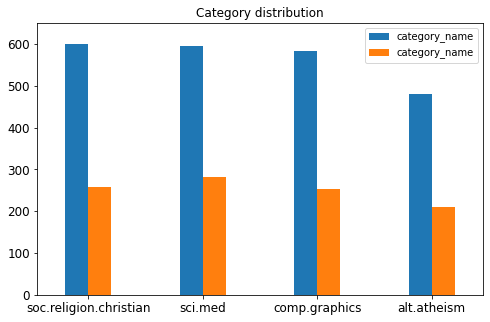

In [12]:
xticks = np.array([0, 1, 2, 3])
bar_width = 0.2
sample_data = X_sample.category_name.value_counts()
original_data = X.category_name.value_counts()

pd.concat([original_data, sample_data], axis=1).plot(kind = 'bar',
                                               title = 'Category distribution',
                                               ylim = [0, 650], 
                                               width = 0.4,
                                               rot = 0, fontsize = 12, figsize = (8,5))

### **>>> Exercise 10 (take home):**
We said that the `1` at the beginning of the fifth record represents the `00` term. Notice that there is another 1 in the same record. Can you provide code that can verify what word this 1 represents from the vocabulary. Try to do this as efficient as possible.

In [13]:
import nltk
from sklearn.feature_extraction.text import CountVectorizer

X['unigrams'] = X['text'].apply(lambda x: dmh.tokenize_text(x))



count_vect = CountVectorizer()
X_counts = count_vect.fit_transform(X.text)

In [14]:
X_counts[0:5, 0:100].toarray()

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0,

### My Answer ###


In [15]:
name_array = np.array(count_vect.get_feature_names()[0:100])
# transform a array like [1, 0, 1, 0, 0 ...] to [True, False, True, False, False ...]
# and this kind of Boolean array can be used by a numpy array as a mask array
mask_array = [i == 1 for i in np.ravel(X_counts[4, 0:100].toarray())]
print(name_array[mask_array])

['00' '01']


And we know the `1`s in the word vector means. The first `1` means `00` and the second `1` means `01`

### **>>> Exercise 11 (take home):** 
From the chart above, we can see how sparse the term-document matrix is; i.e., there is only one terms with frequency of `1` in the subselection of the matrix. By the way, you may have noticed that we only selected 20 articles and 20 terms to plot the histrogram. As an excersise you can try to modify the code above to plot the entire term-document matrix or just a sample of it. How would you do this efficiently? Remember there is a lot of words in the vocab. Report below what methods you would use to get a nice and useful visualization

In [16]:
import seaborn as sns

# first twenty features only
plot_x = ["term_"+str(i) for i in count_vect.get_feature_names()]
# obtain document index
plot_y = ["doc_"+ str(i) for i in list(X.index)]
plot_z = X_counts.toarray()




In [17]:
df_todraw = pd.DataFrame(plot_z, columns = plot_x, index = X.index)

In [18]:
df_todraw.shape

(2257, 35788)

In [19]:
# note this takes time to compute. You may want to reduce the amount of terms you want to compute frequencies for
term_frequencies = np.ravel(np.sum(X_counts, axis=0))



In [20]:
term_frequencies = np.array(term_frequencies)
term_frequencies[term_frequencies > 100].shape

(801,)

In [21]:
threshold = 150
df_todraw_sample = df_todraw.loc[:, term_frequencies > threshold]
print(df_todraw_sample.shape)

(2257, 543)


In [22]:
df_todraw_sample.shape

(2257, 543)

In [23]:
px.imshow(np.log1p((np.log1p(df_todraw_sample))) )

### >>> Exercise 12 (take home):
Please try to reduce the dimension to 3, and plot the result use 3-D plot. Use at least 3 different angle (camera position) to check your result and describe what you found.

$Hint$: you can refer to Axes3D in the documentation.

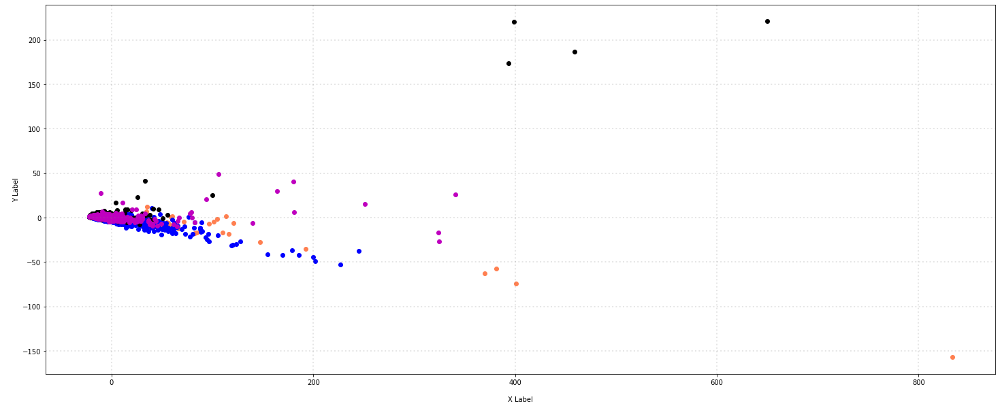

In [24]:
from sklearn.decomposition import PCA
X_reduced = PCA(n_components = 2).fit_transform(X_counts.toarray())
col = ['coral', 'blue', 'black', 'm']

# plot
fig = plt.figure(figsize = (25,10))
ax = fig.subplots()

for c, category in zip(col, categories):
    xs = X_reduced[X['category_name'] == category].T[0]
    ys = X_reduced[X['category_name'] == category].T[1]
   
    ax.scatter(xs, ys, c = c, marker='o')

ax.grid(color='gray', linestyle=':', linewidth=2, alpha=0.2)
ax.set_xlabel('\nX Label')
ax.set_ylabel('\nY Label')

plt.show()

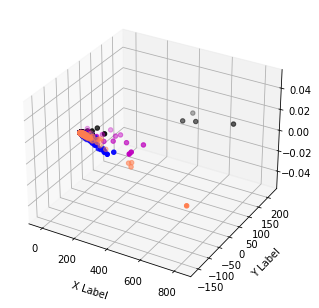

In [25]:
from mpl_toolkits.mplot3d import axes3d, Axes3D

X_reduced = PCA(n_components = 3).fit_transform(X_counts.toarray())
col = ['coral', 'blue', 'black', 'm']

# plot
fig = plt.figure()
ax = Axes3D(fig)


for c, category in zip(col, categories):
    xs = X_reduced[X['category_name'] == category].T[0]
    ys = X_reduced[X['category_name'] == category].T[1]
    zs = X_reduced[X['category_name'] == category].T[2]
   
    ax.scatter(xs, ys, c = c, marker='o')

ax.grid(color='gray', linestyle=':', linewidth=2, alpha=0.2)
ax.set_xlabel('\nX Label')
ax.set_ylabel('\nY Label')

plt.show()

### >>> **Exercise 13 (take home):**
If you want a nicer interactive visualization here, I would encourage you try to install and use plotly to achieve this.

In [26]:
term_frequencies = np.asarray(X_counts.sum(axis=0))[0]

#plt.subplots(figsize=(100, 10))
#g = sns.barplot(x=count_vect.get_feature_names()[:300], 
#            y=term_frequencies[:300])
#g.set_xticklabels(count_vect.get_feature_names()[:300], rotation = 90);

import plotly.express as px
data = pd.DataFrame({'frequency': term_frequencies, 'term': count_vect.get_feature_names()})
fig = px.bar(data.loc[data['frequency'] > 100], x='term', y='frequency')
fig.show()

### >>> **Exercise 14 (take home):** 
The chart above contains all the vocabulary, and it's computationally intensive to both compute and visualize. Can you efficiently reduce the number of terms you want to visualize as an exercise. 

In [27]:
from nltk.corpus import words
nltk.download('words')
len(words.words())

[nltk_data] Downloading package words to
[nltk_data]     C:\Users\crescendoCat\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!


236736

In [28]:
cache = words.words()

def find_in_corpus(t):
    index, item = t
    # for a better performance, drop the terms that frequency less then 1
    if(item.frequency <= 50):
        return False
    # filter out the terms not in dictionary
    return item.term in cache

data['in_dictionary'] =[find_in_corpus(t) for t in progressbar.progressbar(data.iterrows())]

| |                                     #         | 35787 Elapsed Time: 0:00:05


### >>> **Exercise 15 (take home):** 
Additionally, you can attempt to sort the terms on the `x-axis` by frequency instead of in alphabetical order. This way the visualization is more meaninfgul and you will be able to observe the so called [long tail](https://en.wikipedia.org/wiki/Long_tail) (get familiar with this term since it will appear a lot in data mining and other statistics courses). see picture below

![alt txt](https://upload.wikimedia.org/wikipedia/commons/thumb/8/8a/Long_tail.svg/1000px-Long_tail.svg.png)

In [29]:
sorted_data = data.sort_values(by='frequency', ascending=False)
fig = px.bar(sorted_data[sorted_data['in_dictionary']], x='term', y='frequency', log_y=True)
fig.show()

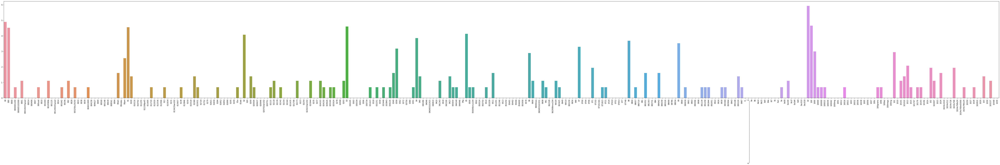

In [30]:
import matplotlib.pyplot as plt
import seaborn as sns
import math
term_frequencies_log = [math.log(i) for i in term_frequencies]
plt.subplots(figsize=(100, 10))
g = sns.barplot(x=count_vect.get_feature_names()[:300],
                y=term_frequencies_log[:300])
g.set_xticklabels(count_vect.get_feature_names()[:300], rotation = 90);

### >>> **Exercise 16 (take home):**
Try to generate the binarization using the `category_name` column instead. Does it work?

In [31]:
from sklearn import preprocessing, metrics, decomposition, pipeline, dummy
mlb = preprocessing.LabelBinarizer()
mlb.fit(X.category_name)
print(mlb.classes_)
X['bin_category'] = mlb.transform(X['category_name']).tolist()
X.head()

['alt.atheism' 'comp.graphics' 'sci.med' 'soc.religion.christian']


,text,category,category_name,unigrams,bin_category
0,From: sd345@city.ac.uk (Michael Collier) Subje...,1,comp.graphics,"[From, :, sd345, @, city.ac.uk, (, Michael, Co...","[0, 1, 0, 0]"
1,From: ani@ms.uky.edu (Aniruddha B. Deglurkar) ...,1,comp.graphics,"[From, :, ani, @, ms.uky.edu, (, Aniruddha, B....","[0, 1, 0, 0]"
2,From: djohnson@cs.ucsd.edu (Darin Johnson) Sub...,3,soc.religion.christian,"[From, :, djohnson, @, cs.ucsd.edu, (, Darin, ...","[0, 0, 0, 1]"
3,From: s0612596@let.rug.nl (M.M. Zwart) Subject...,3,soc.religion.christian,"[From, :, s0612596, @, let.rug.nl, (, M.M, ., ...","[0, 0, 0, 1]"
4,From: stanly@grok11.columbiasc.ncr.com (stanly...,3,soc.religion.christian,"[From, :, stanly, @, grok11.columbiasc.ncr.com...","[0, 0, 0, 1]"


### My Answer ###
It worked. But be careful when doing the fit process of the binarizer. \
The fit process shold use `X.category_name` as well. \
Like: \
`mlb.fit(X.category_name)` \
But not \
`mlb.fit(X.category)` \
This will have problem when doing `mlb.transform(X['category_name'])`


## 2. The New Dataset

### Tasks to Do
1. [Data Source](#1.-Data-Source)
2. [Data Preparation](#2.-Data-Preparation)
3. [Data Transformation](#3.-Data-Transformation) \
    3.1 Converting Dictionary into Pandas dataframe \
    3.2 Familiarizing yourself with the Data
4. [Data Mining using Pandas](#4.-Data-Mining-using-Pandas) \
    4.1 [Dealing with Missing Values](#4.1-Dealing-with-Missing-Values) \
    4.2 [Dealing with Duplicate Data](#4.2-Dealing-with-Duplicate-Data)
5. [Data Preprocessing](#5.-Data-Preprocessing) \
    5.1 [Sampling](#5.1-Sampling) \
    5.2 [Feature Creation](#5.2-Feature-Creation) \
    5.3 [Feature Subset Selection](#5.3-Feature-Subset-Selection) \
    5.4 [Dimensionality Reduction](#5.4-Dimensionality-Reduction) \
    5.5 [Atrribute Transformation / Aggregation](#5.5-Atrribute-Transformation-/-Aggregation) \
    5.6 [Discretization and Binarization](#5.6-Discretization-and-Binarization)
6. [Data Exploration](#6.-Data-Exploration)
7. Conclusion
8. References

### 1. Data Source
The new dataset is about a set of sentence labelled with `positive` or `negative` __sentiment__. \
There are three files I downloaded contain the data in the `./data/` folder: 
1. amazon_cells_labelled.txt
2. imdb_labelled.txt
3. yelp_labelled.txt

So, let's start to prepare our data.
### 2. Data Preparation
Load the data using ```pd.read_table()``` function

In [32]:
# import necessary libraries:
import pandas as pd
from helpers import data_mining_helpers as dmh
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import progressbar as pgbar

In [33]:
amazon = pd.read_table('./data/amazon_cells_labelled.txt', sep='[\t\r]', names=['sentence', 'label'])
imdb = pd.read_table('./data/imdb_labelled.txt', sep='[\r\t]', names=['sentence', 'label'])
yelp = pd.read_table('./data/yelp_labelled.txt', sep='[\r\t]', names=['sentence', 'label'])

c:\python38\lib\site-packages\pandas\io\parsers.py:755: ParserWarning:

Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.



In [34]:
amazon.loc[0]

sentence    So there is no way for me to plug it in here i...
label                                                       0
Name: 0, dtype: object

In [35]:
amazon.head()

,sentence,label
0,So there is no way for me to plug it in here i...,0
1,"Good case, Excellent value.",1
2,Great for the jawbone.,1
3,Tied to charger for conversations lasting more...,0
4,The mic is great.,1


In [36]:
imdb.head()

,sentence,label
0,"A very, very, very slow-moving, aimless movie ...",0
1,Not sure who was more lost - the flat characte...,0
2,Attempting artiness with black & white and cle...,0
3,Very little music or anything to speak of.,0
4,The best scene in the movie was when Gerardo i...,1


In [37]:
yelp.head()

,sentence,label
0,Wow... Loved this place.,1
1,Crust is not good.,0
2,Not tasty and the texture was just nasty.,0
3,Stopped by during the late May bank holiday of...,1
4,The selection on the menu was great and so wer...,1


### 3. Data Transformation
Since we already use the pandas `DataFrame` to read the data, this step we just combine the datasets all together, and skip `3.1` and `3.2`.

In [38]:
# add the 'from' column to tag whhich dataset this record come from
amazon['source'] = 'amazon'
imdb['source'] = 'imdb'
yelp['source'] = 'yelp'

X = pd.concat([amazon, imdb, yelp], axis=0, ignore_index=True)
X.head()

,sentence,label,source
0,So there is no way for me to plug it in here i...,0,amazon
1,"Good case, Excellent value.",1,amazon
2,Great for the jawbone.,1,amazon
3,Tied to charger for conversations lasting more...,0,amazon
4,The mic is great.,1,amazon


In [39]:
# checking data are combined correctly
print("X's Length: %d" % len(X))
for name, item in zip(['amazon', 'imdb', 'yelp'], [amazon, imdb, yelp]):
    print("%6s's length: %4d, number of record come from %6s in X: %4d" % (name, len(item), name, sum(X['source'] == name)) )

X's Length: 3000
amazon's length: 1000, number of record come from amazon in X: 1000
  imdb's length: 1000, number of record come from   imdb in X: 1000
  yelp's length: 1000, number of record come from   yelp in X: 1000


We got totally 3000 records above.

### 4. Data Mining using Pandas
### 4.1 Dealing with Missing Values

In [40]:
# checking missing values
X.isnull().apply(lambda x: dmh.check_missing_values(x))

,sentence,label,source
0,The amoung of missing records is:,The amoung of missing records is:,The amoung of missing records is:
1,0,0,0


Seems that there are no missing value.

### 4.2 Dealing with Duplicate Data

In [41]:
# checking duplicated data
sum(X.duplicated())

17

In [42]:
X[X.duplicated()]

,sentence,label,source
285,Great phone!.,1,amazon
407,Works great.,1,amazon
524,Works great!.,1,amazon
543,Don't buy this product.,0,amazon
744,If you like a loud buzzing to override all you...,0,amazon
748,Does not fit.,0,amazon
778,This is a great deal.,1,amazon
792,Great Phone.,1,amazon
892,Excellent product for the price.,1,amazon
896,Great phone.,1,amazon


In [43]:
X.drop_duplicates(keep='last', inplace=True)

In [44]:
# checking duplicated data again
sum(X.duplicated())

0

In [45]:
# checking data are combined correctly
print("X's Length: %d" % len(X))
for name, item in zip(['amazon', 'imdb', 'yelp'], [amazon, imdb, yelp]):
    print("%6s's length: %4d, number of record come from %6s in X: %4d" % (name, len(item), name, sum(X['source'] == name)) )

X's Length: 2983
amazon's length: 1000, number of record come from amazon in X:  990
  imdb's length: 1000, number of record come from   imdb in X:  997
  yelp's length: 1000, number of record come from   yelp in X:  996


Seems dealed!

### 5. Data Preprocessing
### 5.1 Sampling

In [46]:
X.source.value_counts().index

Index(['imdb', 'yelp', 'amazon'], dtype='object')

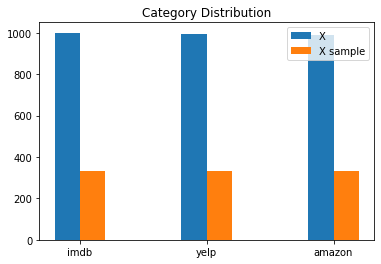

In [47]:
X_sample = X.sample(1000)

x = np.array([0, 1, 2])
bar_width = 0.2
plt.title('Category Distribution')
plt.xticks(x, labels=X.source.value_counts().index)
plt.bar(x-bar_width/2, X.source.value_counts(), width=bar_width)
plt.bar(x+bar_width/2, X_sample.source.value_counts(), width=bar_width)
plt.ylim([0, 1050])
plt.legend(['X', 'X sample'])
plt.show()

### 5.2 Feature Creation

In [48]:
# takes a like a minute or two to process
X['unigrams'] = X['sentence'].apply(lambda x: dmh.tokenize_text(x))

In [49]:
X[0:4]["unigrams"]

0    [So, there, is, no, way, for, me, to, plug, it...
1                 [Good, case, ,, Excellent, value, .]
2                        [Great, for, the, jawbone, .]
3    [Tied, to, charger, for, conversations, lastin...
Name: unigrams, dtype: object

In [50]:
X[0:4]

,sentence,label,source,unigrams
0,So there is no way for me to plug it in here i...,0,amazon,"[So, there, is, no, way, for, me, to, plug, it..."
1,"Good case, Excellent value.",1,amazon,"[Good, case, ,, Excellent, value, .]"
2,Great for the jawbone.,1,amazon,"[Great, for, the, jawbone, .]"
3,Tied to charger for conversations lasting more...,0,amazon,"[Tied, to, charger, for, conversations, lastin..."


In [51]:
list(X[0:1]['unigrams'])

[['So',
  'there',
  'is',
  'no',
  'way',
  'for',
  'me',
  'to',
  'plug',
  'it',
  'in',
  'here',
  'in',
  'the',
  'US',
  'unless',
  'I',
  'go',
  'by',
  'a',
  'converter',
  '.']]

### 5.3 Feature subset selection

In [52]:
from sklearn.feature_extraction.text import CountVectorizer
from nltk.tokenize import word_tokenize

def tok(text):

    tokens = word_tokenize(text)
    return tokens

count_vect = CountVectorizer()
X_counts = count_vect.fit_transform(X.sentence.values)
    

In [53]:
count_vect.get_feature_names()[0:10]

['00', '10', '100', '11', '12', '13', '15', '15g', '15pm', '17']

In [54]:
# first twenty features only
plot_x = ["term_"+str(i) for i in count_vect.get_feature_names()[100:500]]
# obtain document index
plot_y = ["doc_"+ str(i) for i in list(X.index)[100:500]]
plot_z = X_counts[100:500, 100:500].toarray()

df_todraw = pd.DataFrame(plot_z, columns = plot_x, index = plot_y)
fig = px.imshow(df_todraw)

fig.show()

### 5.4 Dimensionality Reduction

In [55]:
from sklearn.decomposition import PCA
X_reduced = PCA(n_components = 2).fit_transform(X_counts.toarray())
print(X_reduced.shape)

(2983, 2)


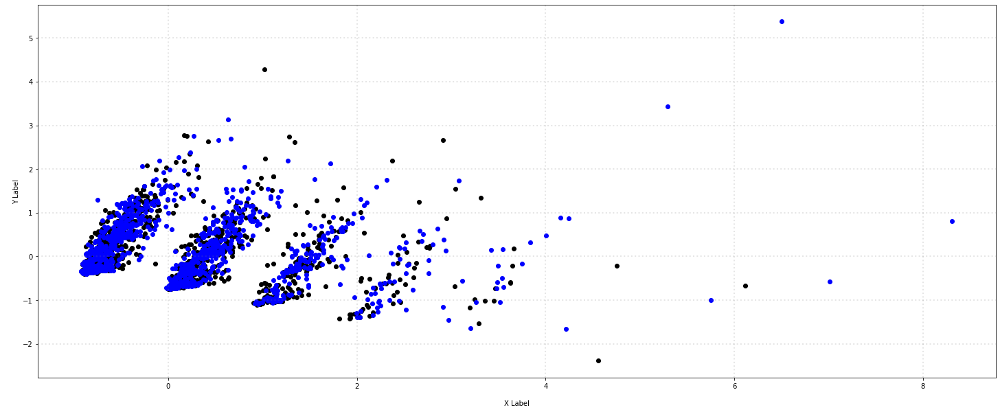

In [56]:
col = ['black', 'blue']

# plot
fig = plt.figure(figsize = (25,10))
ax = fig.subplots()

for c, category in zip(col, [0, 1]):
    xs = X_reduced[X['label'] == category].T[0]
    ys = X_reduced[X['label'] == category].T[1]
   
    ax.scatter(xs, ys, c = c, marker='o')

ax.grid(color='gray', linestyle=':', linewidth=2, alpha=0.2)
ax.set_xlabel('\nX Label')
ax.set_ylabel('\nY Label')

plt.show()

(2983, 3)


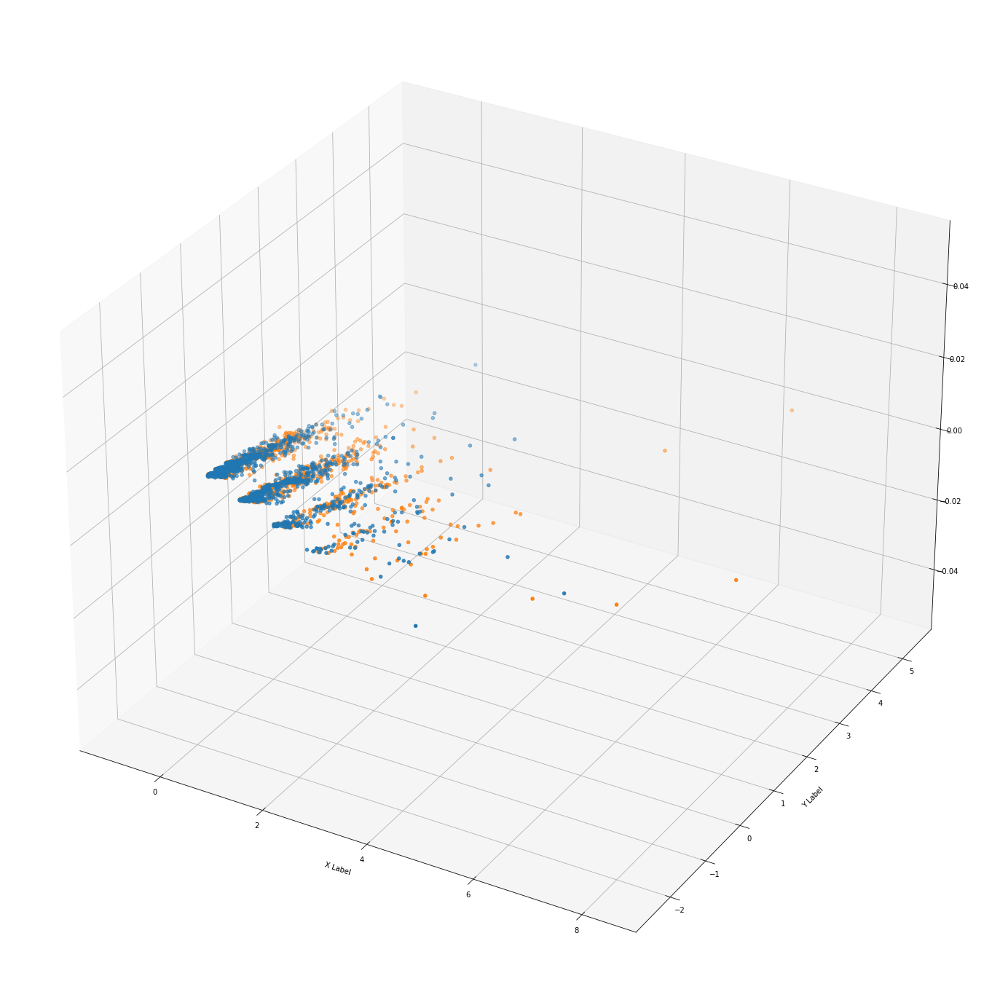

In [57]:
# for 3d plot
from mpl_toolkits.mplot3d import Axes3D

pca_3 = PCA(n_components = 3).fit(X_counts.toarray())

X_reduced_3 = pca_3.transform(X_counts.toarray())
print(X_reduced_3.shape)

# plot
fig = plt.figure(figsize = (25,25))
ax = fig.add_subplot(111, projection='3d')

for label in zip([0, 1]):
    xs = X_reduced_3[X['label'] == label].T[0]
    ys = X_reduced_3[X['label'] == label].T[1]
    zs = X_reduced_3[X['label'] == label].T[2]
   
   
    ax.scatter(xs, ys, marker='o')

ax.grid(color='gray', linestyle=':', linewidth=2, alpha=0.2)
ax.set_xlabel('\nX Label')
ax.set_ylabel('\nY Label')

plt.show()

### 5.5 Atrribute Transformation / Aggregation

In [58]:
import progressbar
# note this takes time to compute. You may want to reduce the amount of terms you want to compute frequencies for

term_frequencies = np.ravel(np.sum(X_counts, axis=0))


In [59]:
max(term_frequencies)

1951

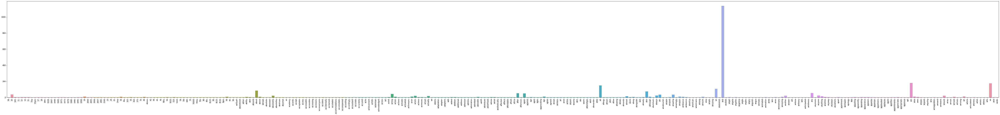

In [60]:
plt.subplots(figsize=(100, 10))
g = sns.barplot(x=count_vect.get_feature_names()[:300], 
            y=term_frequencies[:300])
g.set_xticklabels(count_vect.get_feature_names()[:300], rotation = 90);

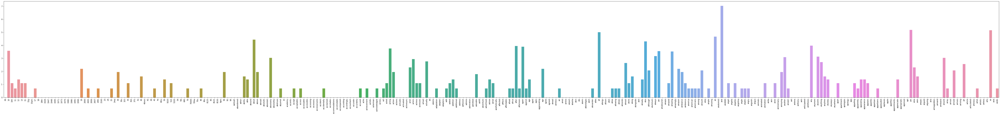

In [61]:
import math
term_frequencies_log = np.log(term_frequencies)

plt.subplots(figsize=(100, 10))
g = sns.barplot(x=count_vect.get_feature_names()[:300],
                y=term_frequencies_log[:300])
g.set_xticklabels(count_vect.get_feature_names()[:300], rotation = 90);

### 5.6 Discretization and Binarization
Since the `label` in __the New Dataset__ is already binarized(positive sentences are labelled by `1` and negetive sentences are labelled by `0`). So we can just skip this step.

 ### 6. Data Exploration

In [62]:
# We retrieve 2 sentences for a random record, here, indexed at 50 and 100
document_to_transform_1 = []
random_record_1 = X.iloc[50]
random_record_1 = random_record_1['sentence']
document_to_transform_1.append(random_record_1)

document_to_transform_2 = []
random_record_2 = X.iloc[100]
random_record_2 = random_record_2['sentence']
document_to_transform_2.append(random_record_2)

document_to_transform_3 = []
random_record_3 = X.iloc[150]
random_record_3 = random_record_3['sentence']
document_to_transform_3.append(random_record_3)
print(document_to_transform_1)
print(document_to_transform_2)
print(document_to_transform_3)

['good protection and does not make phone too bulky.']
['Buyer Beware, you could flush money right down the toilet.']
['Audio Quality is poor, very poor.']


In [63]:
from sklearn.preprocessing import binarize

# Transform sentence with Vectorizers
document_vector_count_1 = count_vect.transform(document_to_transform_1)
document_vector_count_2 = count_vect.transform(document_to_transform_2)
document_vector_count_3 = count_vect.transform(document_to_transform_3)

# Binarize vecors to simplify: 0 for abscence, 1 for prescence
document_vector_count_1_bin = binarize(document_vector_count_1)
document_vector_count_2_bin = binarize(document_vector_count_2)
document_vector_count_3_bin = binarize(document_vector_count_3)

# print
print("Let's take a look at the count vectors:")
print(document_vector_count_1.todense())
print(document_vector_count_2.todense())
print(document_vector_count_3.todense())

Let's take a look at the count vectors:
[[0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]]


In [64]:
from sklearn.metrics.pairwise import cosine_similarity

# Calculate Cosine Similarity
cos_sim_count_1_2 = cosine_similarity(document_vector_count_1, document_vector_count_2, dense_output=True)
cos_sim_count_1_3 = cosine_similarity(document_vector_count_1, document_vector_count_3, dense_output=True)
cos_sim_count_1_1 = cosine_similarity(document_vector_count_1, document_vector_count_1, dense_output=True)
cos_sim_count_2_2 = cosine_similarity(document_vector_count_2, document_vector_count_2, dense_output=True)

# Print 
print("Cosine Similarity using count bw 1 and 2: %(x)f" %{"x":cos_sim_count_1_2})
print("Cosine Similarity using count bw 1 and 3: %(x)f" %{"x":cos_sim_count_1_3})
print("Cosine Similarity using count bw 1 and 1: %(x)f" %{"x":cos_sim_count_1_1})
print("Cosine Similarity using count bw 2 and 2: %(x)f" %{"x":cos_sim_count_2_2})

Cosine Similarity using count bw 1 and 2: 0.000000
Cosine Similarity using count bw 1 and 3: 0.000000
Cosine Similarity using count bw 1 and 1: 1.000000
Cosine Similarity using count bw 2 and 2: 1.000000


In above cell, the Similarity between 1, 2, 3 are all 0 since they are exactly totally different sentences. So the outcome is acceptable.

3. Third: please attempt the following tasks on **the new dataset**. __This part is worth 30% of your grade.__
    - Generate meaningful **new data visualizations**. Refer to online resources and the Data Mining textbook for inspiration and ideas. 
    - Generate **TF-IDF features** from the tokens of each text. This will generating a document matrix, however, the weights will be computed differently (using the TF-IDF value of each word per document as opposed to the word frequency). Refer to this Sciki-learn [guide](http://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html) .
    - Implement a simple **Naive Bayes classifier** that automatically classifies the records into their categories. Use both the TF-IDF features and word frequency features to build two seperate classifiers. Comment on the differences.  Refer to this [article](https://hub.packtpub.com/implementing-3-naive-bayes-classifiers-in-scikit-learn/).


## 3. Classify the Dataset
1. [Visualizations](#1.-Visualizations)
2. [TF-IDF Features](#2.-TF-IDF-Features)
3. [Naive Bayes Classification](#3.-Naive-Bayes-Classification) \
    3.1 [Using TF-IDF](#3.1-Using-TF-IDF) \
    3.2 [Using Word Frequency Features](#3.2-Using-Word-Frequency-Features) \
    3.3 [Simple Discussion](#3.3-Simple-Discussion)

### 1. Visualizations
1. 1 Using a frequency bar plot, but sort the terms using frequency first

In [65]:
df_frequency = pd.DataFrame({'frequency': term_frequencies, 'term': count_vect.get_feature_names()})

df_frequency_sorted = df_frequency.sort_values(by='frequency', ascending=False)
fig = px.bar(df_frequency_sorted[:300], x='term', y='frequency', log_y=True)
fig.show()
fig = px.bar(df_frequency_sorted[300:600], x='term', y='frequency', log_y=True)
fig.show()

But actually most of the first 300 items are the `stop words`, like _the, it, is_ …and so on. \
So I try to plot the frequency plot __without__ `stop words`.

In [66]:
count_vect_sw = CountVectorizer(stop_words='english')
X_counts_sw = count_vect_sw.fit_transform(X.sentence.values)

In [67]:
term_frequencies_sw = np.ravel(np.sum(X_counts_sw, axis=0))


In [68]:
df_frequency_sw = pd.DataFrame({'frequency': term_frequencies_sw, 'term': count_vect_sw.get_feature_names()})

df_frequency_sw_sorted = df_frequency_sw.sort_values(by='frequency', ascending=False)
fig = px.bar(df_frequency_sw_sorted[:300], x='term', y='frequency', log_y=True)
fig.show()
fig = px.bar(df_frequency_sw_sorted[300:600], x='term', y='frequency', log_y=True)
fig.show()

The `explained_variance_` attribute of `pca_3` can represent the importance of each component. \
So we can visualize the importance of the components via a bar plot 

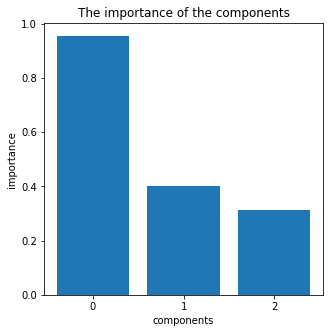

In [69]:
pca_3 = PCA(n_components = 3).fit(X_counts.toarray())

X_reduced_3 = pca_3.transform(X_counts.toarray())

plt.figure(figsize=(5,5))
plt.bar(np.arange(3), pca_3.explained_variance_)
plt.xticks(np.arange(3))
plt.xlabel('components')
plt.ylabel('importance')
plt.title('The importance of the components')
plt.show()

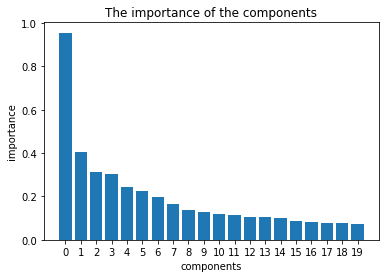

In [70]:
n = 20
pca_n = PCA(n_components=n).fit(X_counts.toarray())

X_reduced_n = pca_n.transform(X_counts.toarray())

plt.bar(np.arange(n), pca_n.explained_variance_)
plt.xticks(np.arange(n))
plt.xlabel('components')
plt.ylabel('importance')
plt.title('The importance of the components')
plt.show()

### 2. TF-IDF Features

In [71]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer()
X_tfidf = vectorizer.fit_transform(X.sentence.values)
vectorizer_sw = TfidfVectorizer(stop_words='english')
X_tfidf_sw = vectorizer_sw.fit_transform(X.sentence.values)

In [91]:
import progressbar
# note this takes time to compute. You may want to reduce the amount of terms you want to compute frequencies for
term_tfidf = np.ravel(np.sum(X_tfidf, axis=0))

# for j in progressbar.progressbar(range(0,X_tfidf.shape[1])):
#    term_tfidf.append(sum(np.ravel(X_tfidf[:,j].toarray())))


In [74]:
idf_mapping = pd.DataFrame({'term': vectorizer.get_feature_names(), 'idf': vectorizer.idf_ })

idf_sorted = idf_mapping.sort_values(by='idf', ascending=False)
fig = px.histogram(idf_mapping, x="idf", nbins=10)
fig.show()

(2983, 2)


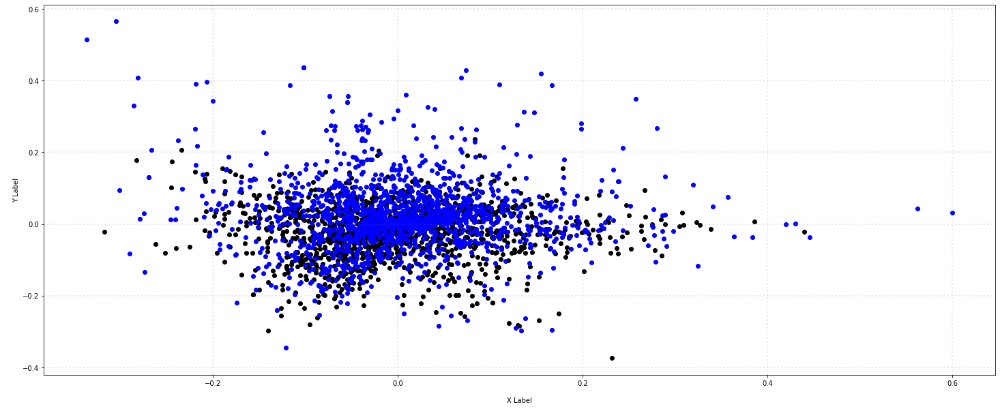

In [75]:
#Try to plot a PCA using n_components=2
from sklearn.decomposition import PCA
X_tfidf_reduced = PCA(n_components = 2).fit_transform(X_tfidf.toarray())
print(X_tfidf_reduced.shape)

col = ['black', 'blue']

# plot
fig = plt.figure(figsize = (25,10))
ax = fig.subplots()

for c, category in zip(col, [0, 1]):
    xs = X_tfidf_reduced[X['label'] == category].T[0]
    ys = X_tfidf_reduced[X['label'] == category].T[1]
   
    ax.scatter(xs, ys, c = c, marker='o')

ax.grid(color='gray', linestyle=':', linewidth=2, alpha=0.2)
ax.set_xlabel('\nX Label')
ax.set_ylabel('\nY Label')

plt.show()

### 3.Naive Bayes Classification
#### 3.1 Using TF-IDF

In [76]:
from sklearn.naive_bayes import BernoulliNB, MultinomialNB
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, plot_roc_curve, auc

In [77]:
acc_df = pd.DataFrame(columns=['dataset', 'classify_method', 'accuracy', 'stop_words'])

In [78]:
X_tfidf_train, X_tfidf_test, y_train, y_test = train_test_split(X_tfidf, X['label'], test_size=0.3, random_state=0)
X_tfidf_sw_train, X_tfidf_sw_test, y_train, y_test = train_test_split(X_tfidf_sw, X['label'], test_size=0.3, random_state=0)

bnb_tfidf = BernoulliNB(binarize=0.0)
bnb_tfidf.fit(X_tfidf_train, y_train)
y_tfidf_train_pred = bnb_tfidf.predict(X_tfidf_train)
y_tfidf_test_pred = bnb_tfidf.predict(X_tfidf_test)
acc_df = acc_df.append( {
                'dataset': 'tfidf', 
                'classify_method': 'bnb',
                'stop_words': False,
                'accuracy': accuracy_score(y_tfidf_test_pred, y_test)
               }, ignore_index=True)


mnb_tfidf = MultinomialNB()
mnb_tfidf.fit(X_tfidf_train, y_train)
y_tfidf_train_pred = mnb_tfidf.predict(X_tfidf_train)
y_tfidf_test_pred = mnb_tfidf.predict(X_tfidf_test)
acc_df = acc_df.append( {
                'dataset': 'tfidf', 
                'classify_method': 'mnb',
                'stop_words': False,
                'accuracy': accuracy_score(y_tfidf_test_pred, y_test)
               }, ignore_index=True)

# Without stop words

bnb_tfidf_sw = BernoulliNB(binarize=0.0)
bnb_tfidf_sw.fit(X_tfidf_sw_train, y_train)
y_tfidf_train_pred = bnb_tfidf_sw.predict(X_tfidf_sw_train)
y_tfidf_test_pred = bnb_tfidf_sw.predict(X_tfidf_sw_test)
acc_df = acc_df.append( {
                'dataset': 'tfidf', 
                'classify_method': 'bnb',
                'stop_words': True,
                'accuracy': accuracy_score(y_tfidf_test_pred, y_test)
               }, ignore_index=True)


mnb_tfidf_sw = MultinomialNB()
mnb_tfidf_sw.fit(X_tfidf_sw_train, y_train)
y_tfidf_train_pred = mnb_tfidf_sw.predict(X_tfidf_sw_train)
y_tfidf_test_pred = mnb_tfidf_sw.predict(X_tfidf_sw_test)
acc_df = acc_df.append( {
                'dataset': 'tfidf', 
                'classify_method': 'mnb',
                'stop_words': True,
                'accuracy': accuracy_score(y_tfidf_test_pred, y_test)
               }, ignore_index=True)


#### 3.2 Using Word Frequency Features

In [79]:
X_counts_train, X_counts_test, y_train, y_test = train_test_split(X_counts, X['label'], test_size=0.3, random_state=0)
X_counts_sw_train, X_counts_sw_test, y_train, y_test = train_test_split(X_counts_sw, X['label'], test_size=0.3, random_state=0)

bnb_counts = BernoulliNB(binarize=0.0)
bnb_counts.fit(X_counts_train, y_train)
y_counts_train_pred = bnb_counts.predict(X_counts_train)
y_counts_test_pred = bnb_counts.predict(X_counts_test)
acc_df = acc_df.append( {
                'dataset': 'counts', 
                'classify_method': 'bnb',
                'stop_words': False,
                'accuracy': accuracy_score(y_counts_test_pred, y_test)
               }, ignore_index=True)


mnb_counts = MultinomialNB()
mnb_counts.fit(X_counts_train, y_train)
y_counts_train_pred = mnb_counts.predict(X_counts_train)
y_counts_test_pred = mnb_counts.predict(X_counts_test)
acc_df = acc_df.append( {
                'dataset': 'counts', 
                'classify_method': 'mnb',
                'stop_words': False,
                'accuracy': accuracy_score(y_counts_test_pred, y_test)
               }, ignore_index=True)

bnb_counts_sw = BernoulliNB(binarize=0.0)
bnb_counts_sw.fit(X_counts_sw_train, y_train)
y_counts_train_pred = bnb_counts_sw.predict(X_counts_sw_train)
y_counts_test_pred = bnb_counts_sw.predict(X_counts_sw_test)
acc_df = acc_df.append( {
                'dataset': 'counts', 
                'classify_method': 'bnb',
                'stop_words': True,
                'accuracy': accuracy_score(y_counts_test_pred, y_test)
               }, ignore_index=True)


mnb_counts_sw = MultinomialNB()
mnb_counts_sw.fit(X_counts_sw_train, y_train)
y_counts_train_pred = mnb_counts_sw.predict(X_counts_sw_train)
y_counts_test_pred = mnb_counts_sw.predict(X_counts_sw_test)
acc_df = acc_df.append( {
                'dataset': 'counts', 
                'classify_method': 'mnb',
                'stop_words': True,
                'accuracy': accuracy_score(y_counts_test_pred, y_test)
               }, ignore_index=True)


And we got a accuracy table

In [80]:
acc_df

,dataset,classify_method,accuracy,stop_words
0,tfidf,bnb,0.817877,False
1,tfidf,mnb,0.808939,False
2,tfidf,bnb,0.793296,True
3,tfidf,mnb,0.798883,True
4,counts,bnb,0.817877,False
5,counts,mnb,0.812291,False
6,counts,bnb,0.793296,True
7,counts,mnb,0.797765,True


In [81]:
acc_df['classify_method_and_stop_words'] = acc_df['classify_method'] + acc_df['stop_words'].astype(str)
display(acc_df.head)

<bound method NDFrame.head of   dataset classify_method  accuracy stop_words classify_method_and_stop_words
0   tfidf             bnb  0.817877      False                       bnbFalse
1   tfidf             mnb  0.808939      False                       mnbFalse
2   tfidf             bnb  0.793296       True                        bnbTrue
3   tfidf             mnb  0.798883       True                        mnbTrue
4  counts             bnb  0.817877      False                       bnbFalse
5  counts             mnb  0.812291      False                       mnbFalse
6  counts             bnb  0.793296       True                        bnbTrue
7  counts             mnb  0.797765       True                        mnbTrue>

#### 3.3 Simple Discussion
First, let me draw some comparation graph to get a more visualized outcome

In [82]:
import plotly.graph_objects as go

fig = px.bar(acc_df.drop(columns=['classify_method', 'stop_words']), x='dataset', y='accuracy', 
            barmode='group', color='classify_method_and_stop_words', range_y=[0.8, 0.825],
            title='Accuracy Comparation between Dataset and Classify Method')
fig.show()

For Bernoulli Naive Bayesian Classifier, the accuracy of TF-IDF(tfidf) and Frequency(counts) are same. \
Since Bernoulli treat numbers as binary.

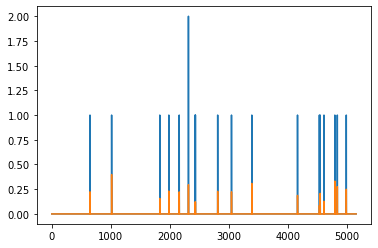

In [83]:
plt.plot(np.arange(5155), np.ravel(X_counts[0].toarray()))
plt.plot(np.arange(5155), np.ravel(X_tfidf[0].toarray()))
plt.show()

The graph above shows two vector on the first record of our data -- the first sentence in amazon_cells_labelled.txt -- "So there is no way for me to plug it in here in the US unless I go by a converter." \
Let's look at the terms and statistics numbers more clearly.

In [84]:
temp = idf_mapping[np.ravel(X_tfidf[0].toarray())> 0]
X_0_feature = pd.DataFrame({
    'term': temp.term,
    'idf': temp.idf,
    'frequency': df_frequency.frequency[np.ravel(X_tfidf[0].toarray())> 0],
    'counts': np.ravel(X_counts[0].toarray())[np.ravel(X_counts[0].toarray())> 0],
    'tfidf': np.ravel(X_tfidf[0].toarray())[np.ravel(X_tfidf[0].toarray())> 0]
})

In [85]:
X_0_feature

,term,idf,frequency,counts,tfidf
647,by,4.657215,78,1,0.223366
1013,converter,8.307873,1,1,0.398455
1829,for,3.261227,334,1,0.156412
1982,go,4.826633,64,1,0.231491
2158,here,4.644311,77,1,0.222747
2314,in,3.079442,400,2,0.295387
2427,is,2.516385,752,1,0.120689
2432,it,2.495236,789,1,0.119674
2809,me,4.766913,71,1,0.228627
3043,no,4.657215,83,1,0.223366


#### Counts or TF-IDF Vectors
Mapping the terms and numbers all together. The vector is very sparse that the value not in the table are all zero. \
And a Bernoulli will treat all positive value above as 1, so TF-IDF vector and counts vector in Bernoulli are the same! \
This is how Bernoulli Naive Bayesian Classifier has same accuracy on two different features. \
But for Multinomial Naive Bayesian Classifier, this classifier treat numbers in multinomial distribution. Since the treatment is no longer 0 or 1, I expected the outcome of TF-IDF will better than simple Frequency based CountVector. \
But the truth is not. CountVector even better than TF-IDF, although the difference of accuracy is less than 0.01. \
So I try to use a cross validation to see the average performance of two dataset.

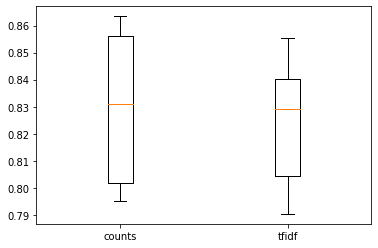

In [86]:
from sklearn.model_selection import cross_val_score, KFold

classifier = MultinomialNB()
cv=KFold(n_splits=12, shuffle=True, random_state=0)

acc_counts = cross_val_score(classifier, X_counts.toarray(), X['label'], cv=cv)
acc_tfidf = cross_val_score(classifier, X_tfidf.toarray(), X['label'], cv=cv)
plt.boxplot([acc_counts, acc_tfidf])
plt.xticks([1, 2], ['counts', 'tfidf'])
plt.show()

And also plot a __ROC Curve__ 

Text(0.5, 0.98, 'ROC curve comparison of Frequency Features')

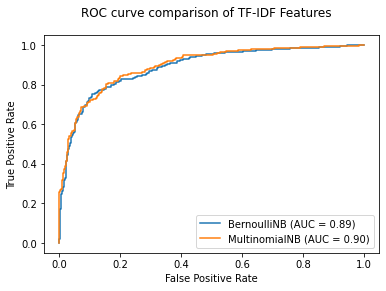

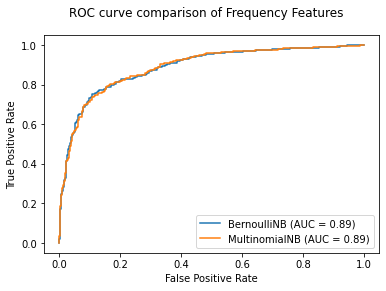

In [87]:
bnb_tfidf_disp = plot_roc_curve(bnb_tfidf, X_tfidf_test, y_test)
plot_roc_curve(mnb_tfidf, X_tfidf_test, y_test, ax=bnb_tfidf_disp.ax_)
bnb_tfidf_disp.figure_.suptitle("ROC curve comparison of TF-IDF Features")
bnb_counts_disp = plot_roc_curve(bnb_counts, X_counts_test, y_test)
plot_roc_curve(mnb_counts, X_counts_test, y_test, ax=bnb_counts_disp.ax_)
bnb_counts_disp.figure_.suptitle("ROC curve comparison of Frequency Features")

In [88]:
from sklearn.metrics.pairwise import cosine_similarity
cos_sim = cosine_similarity(X_counts, X_tfidf, dense_output=True)

In [89]:
fig = px.imshow(cos_sim[:500, :500])
fig.show()

In [90]:
import plotly.graph_objects as go

fig = go.Figure(data=[
    go.Bar(name=n, x=X_0_feature['term'], y=X_0_feature[n]) for n in ['counts', 'tfidf']
])
# Change the bar mode
fig.update_layout(barmode='group')
fig.show()

From the similarity matrix we can see X_tfidf and X_counts are very similar. So the prediction by classifier using two matrix will also very similar. \
And TF-IDF feature may not so powerful in this dataset


#### Stop Words
For those classifiers using a dataset without stop words, the everage performance are lower then those who using a dataset with stop words. \
This also shows that sometimes ignore stop words may have a loss on classification.

## 4. Lab1 Feedback
For me, the most inefficent part must be counting the frequency of terms. \
in
```python
term_frequencies = []
for j in progressbar.progressbar(range(0,X_counts.shape[1])):
    term_frequencies.append(sum(np.ravel(X_counts[:,j].toarray())))
```
I use a [progressbar](https://pypi.org/project/progressbar2/) to show a visualized progress when my cpu is doing this long compute. The problem of the efficecy may come frome the 
```python
X_tfidf[:, j].toarray() 
```
term. We have about 30k terms in our dataset and it will do 30k times `toarray()` ! \
And the `sum()` function is also implemented by `numpy` library. \
So in my homework I replaced all frequency computation into
```python
term_frequencies = np.ravel(np.sum(X_counts, axis=0))
```
This will do a totally same work as the codes above, but much faster.

In [96]:
X = pd.DataFrame.from_records(dmh.format_rows(twenty_train), columns= ['text'])
X_counts = CountVectorizer().fit_transform(X['text'])

In [97]:
import time
start_time = time.time()


term_frequencies = []
for j in progressbar.progressbar(range(0,X_counts.shape[1])):
    term_frequencies.append(sum(X_counts[:,j].toarray()))
    
time_to_execute = time.time() - start_time
print("--- %s seconds ---" % time_to_execute)

100% (35788 of 35788) |##################| Elapsed Time: 0:01:48 Time:  0:01:48


--- 108.95140480995178 seconds ---


In [105]:
start_time = time.time()
term_frequencies_2 = np.ravel(np.sum(X_counts, axis=0))
time_to_execute_2 = time.time() - start_time
print("--- %s seconds ---" % time_to_execute_2)

--- 0.0009996891021728516 seconds ---


Let check if the outcome is same or not

In [102]:
np.array_equal(np.array(term_frequencies), term_frequencies_2)

True

In [106]:
time_to_execute / time_to_execute_2

108985.28809921298

Well, the faster one is about 100k faster than the slower one.

The other part, such as Pandas missing value checking, duplicated value checking, Bag-of-Word computing(CountVtorizer), PCA feature reducing, are all very useful techniques on data preprocessing and mining. \
A lots of thanks to TAs!